In [1]:
'''
Population data from FRED API

'''

import requests
import pandas as pd
%matplotlib inline
import matplotlib.pyplot as plt
from datetime import datetime
plt.style.use('seaborn-whitegrid')
import numpy as np
from dateutil import parser

In [2]:
population_titles_of_interest_start_substrings = [
    'Employment to Population Ratio',
    'Age Dependency Ratio: Older Dependents to Working-Age Population',
    'Population Ages 15 to 64',
    'Population, Total' 
]


In [3]:
countries_of_interest = ['Japan', 'China', 'United States', 'South Korea' ,'Germany', 'United Kingdom' ]

In [4]:
#fred_url =  'https://api.stlouisfed.org/fred/series/search?api_key=4a35874b8a4526dd50b390e46f396651&search_text={0}&file_type=json'  


def do_series_search(search_data):
    '''
    Does a search of FRED data series
    INPUT: data to seach (list of strings)
    OUTPUT: json results from FRED
    '''
    fred_search_url = 'https://api.stlouisfed.org/fred/series/search?api_key=4a35874b8a4526dd50b390e46f396651&search_text={0}&file_type=json'  
    if type(search_data) != type(list):
        search_data = [search_data]
    search_string = '+'.join([x.lower() for x in search_data])
    fred_response = requests.get(fred_search_url.format(search_string))
    result = fred_response.json()
    return result
    
def get_series(series_id):
    '''
    Fetches FRED data series
    INPUT: data to seach (list of strings)
    OUTPUT: json results from FRED
    '''
    fred_series_fetch_url = 'https://api.stlouisfed.org/fred/series/observations?series_id={0}' + \
'&api_key=4a35874b8a4526dd50b390e46f396651&file_type=json'
    fred_response = requests.get(fred_series_fetch_url.format(series_id))
    result = fred_response.json()
    #print(result)
    return result 


def get_population_data(country):
    '''
    Get Poplatation data from FRED
    INPUT: Country (String)
    OUTPUT: dictionary of data 
    '''
    population_titles_of_interest = [
    'Employment to Population Ratio for',
    'Age Dependency Ratio: Older Dependents to Working-Age Population for',
    'Population Ages 15 to 64 for',
    'Population, Total for' 
    ]
    country_series  = do_series_search(country.lower())
    series_ids = {}
    series_notes = {}
    print(country_series)
    for elem in country_series['seriess']:
        #print(elem)
        for title in population_titles_of_interest:
            #if elem['title'].startswith(title):
            if 'population' in elem['title'].lower():
                series_ids[elem['title']] = elem['id']
                series_notes[elem['title']] = elem['notes']
    #print(series_ids)
    ans = {}
    for title, series_id in series_ids.items():
        series = {}
        series_info = get_series(series_id)
        series['title'] = title
        series['units'] = series_info['units']
        series['notes'] = series_notes[title]
        series['dates'] = [x['date'] for x in series_info['observations']]
        series['values'] = [x['value'] for x in series_info['observations']]
        ans[title] = series
    
    return ans


def get_series_info_by_title(title, country):
    save_country = country
    if country.lower() == 'south korea':
        country = 'republic of korea'
    country_series  = do_series_search(country.lower())
    series_ids = {}
    series_notes = {}
    for elem in country_series['seriess']:
        print(elem['title'] ,elem['frequency'])
        print(elem)
        if title.lower() ==  elem['title'].lower():
            if 'frequency' in elem:
                if elem['frequency'].lower() == 'annual':
                    print('found one {0}'.format(title))
                    print(elem)
                    series_ids[elem['title']] = elem['id']
                    series_notes[elem['title']] = elem['notes']
    #print(series_ids)
    ans = {}
    for title, series_id in series_ids.items():
        series = {}
        series_info = get_series(series_id)
        series['title'] = title
        series['units'] = series_info['units']
        series['notes'] = series_notes[title]
        series['dates'] = [x['date'] for x in series_info['observations']]
        series['values'] = [x['value'] for x in series_info['observations']]
        ans[save_country] = series
    return ans
    

        
                
    
    
    

In [5]:


def get_total_population_data_for_counry_set(country_set):
    country_set_data = {}
    for country in country_set:
        save_country = country
        country = country.lower()
        title_string = 'population for {0}'.format(country)
        if country.lower() in {'usa', 'united states'}:
            title_string = 'population, total for united states' 
        info = get_series_info_by_title(title_string, save_country)
        country_set_data[save_country] = info
    return country_set_data

def get_working_age_percent_for_country_set(country_set):
    country_set_data = {}
    for country in country_set:
        save_country = country
        country = country.lower()
        title_string = 'population ages 15 to 64 for {0}'.format(country)
        info = get_series_info_by_title(title_string, save_country)
        country_set_data[save_country] = info
    return country_set_data
    
    
    

In [6]:
country_set = ['China', 'Japan', 'Republic of Korea', 'Germany', 'United States']

In [7]:
total_population_set = get_total_population_data_for_counry_set(country_set)

China / U.S. Foreign Exchange Rate Daily
{'id': 'DEXCHUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'China / U.S. Foreign Exchange Rate', 'observation_start': '1981-01-02', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'Chinese Yuan to One U.S. Dollar', 'units_short': 'Chinese Yuan to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:02-06', 'popularity': 71, 'group_popularity': 76, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
China / U.S. Foreign Exchange Rate Monthly
{'id': 'EXCHUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'China / U.S. Foreign Exchange Rate', 'observation_start': '1981-01-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Chinese Yuan to One U.S. Dollar', 'units_short': 'Chinese Yuan to  

{'id': 'CHNNGDPDUSD', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'National Accounts: Gross Domestic Product for China, P.R.: Mainland', 'observation_start': '2016-01-01', 'observation_end': '2024-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'U.S. Dollars', 'units_short': 'U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-10-23 14:08:05-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'Annual data observations begin 3 years before publication. Projected data include the year of publication and the subsequent 5 years. The data and projections presented are forecasted estimates by the IMF staff based on data available through early September 2015.\n\nCopyright © 2016, International Monetary Fund. Reprinted with permission. Complete terms of use and contact details are available at http://www.imf.org/external/terms.htm.'}
H-Statistic in Banking Market for China Annual
{'id

Value of Exports to China from Mississippi Annual
{'id': 'MSCHNA052SCEN', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Value of Exports to China from Mississippi', 'observation_start': '1992-01-01', 'observation_end': '2016-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Dollars', 'units_short': '$', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2018-06-26 09:41:53-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'This data series illustrates the movement of exports from the given state to the given country. A missing observation can mean two things. First, missing observations can appear because no exports were made to the listed country that year. Secondly, it could signify a low number of exporters thus giving away proprietary data away.'}
Value of Exports to China from Nevada Annual
{'id': 'NVCHNA052SCEN', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': '

Japan / U.S. Foreign Exchange Rate Daily
{'id': 'DEXJPUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Japan / U.S. Foreign Exchange Rate', 'observation_start': '1971-01-04', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'Japanese Yen to One U.S. Dollar', 'units_short': 'Japanese Yen to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:02-06', 'popularity': 66, 'group_popularity': 72, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
Japan / U.S. Foreign Exchange Rate Monthly
{'id': 'EXJPUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Japan / U.S. Foreign Exchange Rate', 'observation_start': '1971-01-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Japanese Yen to One U.S. Dollar', 'units_short': 'Japanese Yen to  

Production: Construction: Total construction: Total for Japan Monthly
{'id': 'JPNPRCNTO01GPSAM', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Production: Construction: Total construction: Total for Japan', 'observation_start': '1993-02-01', 'observation_end': '2019-07-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Growth rate previous period', 'units_short': 'Growth rate previous period', 'seasonal_adjustment': 'Seasonally Adjusted', 'seasonal_adjustment_short': 'SA', 'last_updated': '2019-10-09 16:38:09-05', 'popularity': 1, 'group_popularity': 4, 'notes': 'OECD descriptor ID: PRCNTO01 OECD unit ID: GPSA OECD country ID: JPN All OECD data should be cited as follows: OECD,"Main Economic Indicators - complete database"Main Economic Indicators(database)http://dx.doi.org/10.1787/data-00052-en(Accessed on date)Copyright, 2016, OECD. Reprinted with permission.'}
Production: Construction: Total construction: Total for Japan Quarterly
{'id': 'JPNPRCN

{'id': 'JPYONTD156N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Spot Next London Interbank Offered Rate (LIBOR), based on Japanese Yen', 'observation_start': '2001-01-02', 'observation_end': '2019-11-05', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 07:01:08-06', 'popularity': 16, 'group_popularity': 16, 'notes': 'The data series is lagged by one week due to an agreement with the source.\nLondon Interbank Offered Rate is the average interest rate at which leading banks borrow funds of a sizeable amount from other banks in the London market. Libor is the most widely used "benchmark" or reference rate for short term interest rates\n\nIn consideration for ICE Benchmark Administration Limited ("IBA") coordinating and the Libor Contributor Banks supplying the data from which ICE LIBOR is compiled, the subscri

Broad Money, Index for Japan (DISCONTINUED) Quarterly
{'id': 'MABMBM01JPQ657S', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Broad Money, Index for Japan (DISCONTINUED)', 'observation_start': '1980-04-01', 'observation_end': '2013-10-01', 'frequency': 'Quarterly', 'frequency_short': 'Q', 'units': 'Growth Rate Previous Period', 'units_short': 'Growth Rate Previous Period', 'seasonal_adjustment': 'Seasonally Adjusted', 'seasonal_adjustment_short': 'SA', 'last_updated': '2014-05-05 09:23:45-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'OECD descriptor ID: MABMBM01\nOECD unit ID: GPSA\nOECD country ID: JPN\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Broad Money, Index for Japan (DISCONTINUED) Quarterly
{'id': 'MABMBM01JPQ659S', 'realtime_start': '2019-11-

South Korea / U.S. Foreign Exchange Rate Daily
{'id': 'DEXKOUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'South Korea / U.S. Foreign Exchange Rate', 'observation_start': '1981-04-13', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'South Korean Won to One U.S. Dollar', 'units_short': 'South Korean Won to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:03-06', 'popularity': 58, 'group_popularity': 62, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
South Korea / U.S. Foreign Exchange Rate Monthly
{'id': 'EXKOUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'South Korea / U.S. Foreign Exchange Rate', 'observation_start': '1981-04-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'South Korean Won to One U.S. Dollar

Gross Domestic Product by Expenditure in Constant Prices: Change in Stocks for the Republic of Korea Quarterly
{'id': 'NAEXKP05KRQ189S', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Gross Domestic Product by Expenditure in Constant Prices: Change in Stocks for the Republic of Korea', 'observation_start': '2000-01-01', 'observation_end': '2019-04-01', 'frequency': 'Quarterly', 'frequency_short': 'Q', 'units': 'National Currency', 'units_short': 'National Currency', 'seasonal_adjustment': 'Seasonally Adjusted', 'seasonal_adjustment_short': 'SA', 'last_updated': '2019-09-11 11:25:10-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'OECD descriptor ID: NAEXKP05\nOECD unit ID: STSA\nOECD country ID: KOR\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Gross Domesti

Current Account Debit: Total Income for the Republic of Korea (DISCONTINUED) Quarterly
{'id': 'BPDBIN01KRQ637N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Current Account Debit: Total Income for the Republic of Korea (DISCONTINUED)', 'observation_start': '1980-01-01', 'observation_end': '2013-10-01', 'frequency': 'Quarterly', 'frequency_short': 'Q', 'units': 'US Dollars, Sum Over Component Sub-periods', 'units_short': 'US $, Sum Over Component Sub-periods', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2017-04-13 02:13:45-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'OECD descriptor ID: BPDBIN01\nOECD unit ID: CXCU\nOECD country ID: KOR\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Current Acco

Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Germany Monthly
{'id': 'IRLTLT01DEM156N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Germany', 'observation_start': '1960-01-01', 'observation_end': '2019-09-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-10-09 16:34:03-05', 'popularity': 62, 'group_popularity': 63, 'notes': 'OECD descriptor ID: IRLTLT01\nOECD unit ID: ST\nOECD country ID: DEU\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Ge

Financial Account: Net Direct Investment for Germany (DISCONTINUED) Quarterly
{'id': 'BPFADI01DEQ637N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Financial Account: Net Direct Investment for Germany (DISCONTINUED)', 'observation_start': '1971-01-01', 'observation_end': '2014-01-01', 'frequency': 'Quarterly', 'frequency_short': 'Q', 'units': 'US Dollars, Sum Over Component Sub-periods', 'units_short': 'US $, Sum Over Component Sub-periods', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2017-04-15 13:04:06-05', 'popularity': 1, 'group_popularity': 3, 'notes': 'OECD descriptor ID: BPFADI01\nOECD unit ID: CXCU\nOECD country ID: DEU\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Financial Account: Net Direct 

{'id': 'KCPPPGDEA156NUPN', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Consumption Share of Purchasing Power Parity Converted GDP Per Capita at constant prices for Germany', 'observation_start': '1970-01-01', 'observation_end': '2010-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2012-09-17 10:14:33-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'For more information and proper citation see http://www.rug.nl/research/ggdc/data/pwt/pwt-7.1\n\nSource Indicator: kc'}
Consumer Price Index: Harmonised prices: Energy: Total for Germany Monthly
{'id': 'DEUCPHPEN01IXOBM', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Consumer Price Index: Harmonised prices: Energy: Total for Germany', 'observation_start': '1996-01-01', 'observation_end': '2019-08-01', 'frequency': 'Monthly', 'frequency

Assets: Total Assets: Total Assets (Less Eliminations From Consolidation): Wednesday Level Weekly, As of Wednesday
{'id': 'WALCL', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Assets: Total Assets: Total Assets (Less Eliminations From Consolidation): Wednesday Level', 'observation_start': '2002-12-18', 'observation_end': '2019-11-06', 'frequency': 'Weekly, As of Wednesday', 'frequency_short': 'W', 'units': 'Millions of U.S. Dollars', 'units_short': 'Mil. of U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-07 15:47:01-06', 'popularity': 87, 'group_popularity': 87}
U.S. / Euro Foreign Exchange Rate Daily
{'id': 'DEXUSEU', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'U.S. / Euro Foreign Exchange Rate', 'observation_start': '1999-01-04', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'U.S. Dollars to One Euro', 'units_short': 

{'id': 'A065RC1A027NBEA', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Personal income', 'observation_start': '1929-01-01', 'observation_end': '2018-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Billions of Dollars', 'units_short': 'Bil. of $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-07-26 07:55:12-05', 'popularity': 22, 'group_popularity': 59, 'notes': 'BEA Account Code: A065RC\n\nPersonal income is the income that persons receive in return for their provision of labor, land, and capital used in current production and the net current transfer payments that they receive from business and from government.25 Personal income is equal to national income minus corporate profits with inventory valuation and capital consumption adjustments, taxes on production and imports less subsidies, contributions for government social insurance, net interest and miscellaneous payments on asse

In [8]:
total_population_set

{'China': {'China': {'title': 'Population for China',
   'units': 'lin',
   'notes': 'Source ID: pop\n\nWhen using these data in your research, please make the following reference: Feenstra, Robert C., Robert Inklaar and Marcel P. Timmer (2015), "The Next Generation of the Penn World Table" American Economic Review, 105(10), 3150-3182, available for download at www.ggdc.net/pwt\n\nFor more information, see http://www.rug.nl/research/ggdc/data/pwt/.',
   'dates': ['1952-01-01',
    '1953-01-01',
    '1954-01-01',
    '1955-01-01',
    '1956-01-01',
    '1957-01-01',
    '1958-01-01',
    '1959-01-01',
    '1960-01-01',
    '1961-01-01',
    '1962-01-01',
    '1963-01-01',
    '1964-01-01',
    '1965-01-01',
    '1966-01-01',
    '1967-01-01',
    '1968-01-01',
    '1969-01-01',
    '1970-01-01',
    '1971-01-01',
    '1972-01-01',
    '1973-01-01',
    '1974-01-01',
    '1975-01-01',
    '1976-01-01',
    '1977-01-01',
    '1978-01-01',
    '1979-01-01',
    '1980-01-01',
    '1981-01-0

In [9]:
working_population_set = get_working_age_percent_for_country_set(country_set)

China / U.S. Foreign Exchange Rate Daily
{'id': 'DEXCHUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'China / U.S. Foreign Exchange Rate', 'observation_start': '1981-01-02', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'Chinese Yuan to One U.S. Dollar', 'units_short': 'Chinese Yuan to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:02-06', 'popularity': 71, 'group_popularity': 76, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
China / U.S. Foreign Exchange Rate Monthly
{'id': 'EXCHUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'China / U.S. Foreign Exchange Rate', 'observation_start': '1981-01-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Chinese Yuan to One U.S. Dollar', 'units_short': 'Chinese Yuan to  

Price Level of Exports for Province of China Taiwan Annual
{'id': 'PLXCPPTWA670NRUG', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Price Level of Exports for Province of China Taiwan', 'observation_start': '1951-01-01', 'observation_end': '2017-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Price Level of USA Output-side GDP in 2011=1', 'units_short': 'Price Level of USA Output-side GDP in 2011=1', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-06-11 13:11:04-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'Source ID: pl_x\n\nWhen using these data in your research, please make the following reference: Feenstra, Robert C., Robert Inklaar and Marcel P. Timmer (2015), "The Next Generation of the Penn World Table" American Economic Review, 105(10), 3150-3182, available for download at www.ggdc.net/pwt\n\nFor more information, see http://www.rug.nl/research/ggdc/data/pwt/.'}
Use o

Japan / U.S. Foreign Exchange Rate Daily
{'id': 'DEXJPUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Japan / U.S. Foreign Exchange Rate', 'observation_start': '1971-01-04', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'Japanese Yen to One U.S. Dollar', 'units_short': 'Japanese Yen to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:02-06', 'popularity': 66, 'group_popularity': 72, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
Japan / U.S. Foreign Exchange Rate Monthly
{'id': 'EXJPUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Japan / U.S. Foreign Exchange Rate', 'observation_start': '1971-01-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Japanese Yen to One U.S. Dollar', 'units_short': 'Japanese Yen to  

{'id': 'BPFAPI02JPQ636N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Financial Account: Portfolio Investment Assets for Japan (DISCONTINUED)', 'observation_start': '1985-01-01', 'observation_end': '2013-10-01', 'frequency': 'Quarterly', 'frequency_short': 'Q', 'units': 'National currency, Sum Over Component Sub-periods', 'units_short': 'National currency, Sum Over Component Sub-periods', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2014-03-12 11:34:48-05', 'popularity': 2, 'group_popularity': 2, 'notes': 'OECD descriptor ID: BPFAPI02\nOECD unit ID: NCCU\nOECD country ID: JPN\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Ratio of Female to Male Secondary School Enrollment for Japan Annual
{'id': 'SEENRSE

South Korea / U.S. Foreign Exchange Rate Daily
{'id': 'DEXKOUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'South Korea / U.S. Foreign Exchange Rate', 'observation_start': '1981-04-13', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'South Korean Won to One U.S. Dollar', 'units_short': 'South Korean Won to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:03-06', 'popularity': 58, 'group_popularity': 62, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
South Korea / U.S. Foreign Exchange Rate Monthly
{'id': 'EXKOUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'South Korea / U.S. Foreign Exchange Rate', 'observation_start': '1981-04-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'South Korean Won to One U.S. Dollar

Gross Portfolio Debt Liabilities to GDP for Republic of Korea Annual
{'id': 'DDDM10KRA156NWDB', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Gross Portfolio Debt Liabilities to GDP for Republic of Korea', 'observation_start': '2009-01-01', 'observation_end': '2017-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-10-21 14:50:40-05', 'popularity': 1, 'group_popularity': 1, 'notes': "Ratio of gross portfolio debt liabilities to GDP. Debt liabilities cover (1) bonds, debentures, notes, etc., and (2) money market or negotiable debt instruments.\n\nRatio of gross portfolio debt liabilities to GDP. Debt liabilities cover (1) bonds, debentures, notes, etc., and (2) money market or negotiable debt instruments. Raw data are from the electronic version of the IMF's International Financial Statistics. IFS line 79AEDZF /

Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Germany Monthly
{'id': 'IRLTLT01DEM156N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Germany', 'observation_start': '1960-01-01', 'observation_end': '2019-09-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-10-09 16:34:03-05', 'popularity': 62, 'group_popularity': 63, 'notes': 'OECD descriptor ID: IRLTLT01\nOECD unit ID: ST\nOECD country ID: DEU\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Ge

Total Industry Production Excluding Construction for Germany Quarterly
{'id': 'PRINTO01DEQ659S', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Total Industry Production Excluding Construction for Germany', 'observation_start': '1960-01-01', 'observation_end': '2019-04-01', 'frequency': 'Quarterly', 'frequency_short': 'Q', 'units': 'Growth Rate Same Period Previous Year', 'units_short': 'Growth Rate Same Period Previous Yr.', 'seasonal_adjustment': 'Seasonally Adjusted', 'seasonal_adjustment_short': 'SA', 'last_updated': '2019-10-09 16:41:32-05', 'popularity': 1, 'group_popularity': 3, 'notes': 'OECD descriptor ID: PRINTO01\nOECD unit ID: GYSA\nOECD country ID: DEU\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Total Industry Production Excluding Construction for G

{'id': 'CUAEEFDEA052N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Current Account (Excludes Exceptional Financing), Net for Germany', 'observation_start': '1971-01-01', 'observation_end': '2008-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Dollars', 'units_short': '$', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2013-03-05 10:31:12-06', 'popularity': 1, 'group_popularity': 1, 'notes': 'Notes regarding this series can be found in International Financial Statistics Yearbooks produced by the International Monetary Fund (IMF). We have requested these publications from the IMF. Notes on this series will populate once they become available.\n\nCopyright © 2016, International Monetary Fund. Reprinted with permission. Complete terms of use and contact details are available at http://www.imf.org/external/terms.htm.'}
Current Account (Excludes Exceptional Financing), Net for Germany Quarte

Assets: Total Assets: Total Assets (Less Eliminations From Consolidation): Wednesday Level Weekly, As of Wednesday
{'id': 'WALCL', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Assets: Total Assets: Total Assets (Less Eliminations From Consolidation): Wednesday Level', 'observation_start': '2002-12-18', 'observation_end': '2019-11-06', 'frequency': 'Weekly, As of Wednesday', 'frequency_short': 'W', 'units': 'Millions of U.S. Dollars', 'units_short': 'Mil. of U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-07 15:47:01-06', 'popularity': 87, 'group_popularity': 87}
U.S. / Euro Foreign Exchange Rate Daily
{'id': 'DEXUSEU', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'U.S. / Euro Foreign Exchange Rate', 'observation_start': '1999-01-04', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'U.S. Dollars to One Euro', 'units_short': 

Real Imports of Goods and Services Quarterly
{'id': 'A021RO1Q156NBEA', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Real Imports of Goods and Services', 'observation_start': '1948-01-01', 'observation_end': '2019-07-01', 'frequency': 'Quarterly', 'frequency_short': 'Q', 'units': 'Percent Change from Quarter One Year Ago', 'units_short': '% Chg. from Qtr.  1 Yr. Ago', 'seasonal_adjustment': 'Seasonally Adjusted', 'seasonal_adjustment_short': 'SA', 'last_updated': '2019-10-30 08:04:16-05', 'popularity': 7, 'group_popularity': 60, 'notes': 'BEA Account Code: A021RO\n\nFor more information about this series, please see http://www.bea.gov/national/.'}
Real Imports of Goods and Services Quarterly
{'id': 'OB000342Q', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Real Imports of Goods and Services', 'observation_start': '2003-01-01', 'observation_end': '2019-07-01', 'frequency': 'Quarterly', 'frequency_short': 'Q', 'units': 'Percent Change f

In [10]:
working_population_set

{'China': {'China': {'title': 'Population Ages 15 to 64 for China',
   'units': 'lin',
   'notes': 'Source Indicator: SP.POP.1564.TO.ZS',
   'dates': ['1950-01-01',
    '1951-01-01',
    '1952-01-01',
    '1953-01-01',
    '1954-01-01',
    '1955-01-01',
    '1956-01-01',
    '1957-01-01',
    '1958-01-01',
    '1959-01-01',
    '1960-01-01',
    '1961-01-01',
    '1962-01-01',
    '1963-01-01',
    '1964-01-01',
    '1965-01-01',
    '1966-01-01',
    '1967-01-01',
    '1968-01-01',
    '1969-01-01',
    '1970-01-01',
    '1971-01-01',
    '1972-01-01',
    '1973-01-01',
    '1974-01-01',
    '1975-01-01',
    '1976-01-01',
    '1977-01-01',
    '1978-01-01',
    '1979-01-01',
    '1980-01-01',
    '1981-01-01',
    '1982-01-01',
    '1983-01-01',
    '1984-01-01',
    '1985-01-01',
    '1986-01-01',
    '1987-01-01',
    '1988-01-01',
    '1989-01-01',
    '1990-01-01',
    '1991-01-01',
    '1992-01-01',
    '1993-01-01',
    '1994-01-01',
    '1995-01-01',
    '1996-01-01',
    '19

In [11]:

working_age_population_set = {
'Germany':'Working Age Population: Aged 15-64: All Persons for Germany',
'South Korea':'Working Age Population: Aged 15-64: All Persons for the Republic of Korea',
'Japan':'Working Age Population: Aged 15-64: All Persons for Japan',
'USA':'Working Age Population: Aged 15-64: All Persons for the United States',
'China':'Population Ages 15 to 64 for China', # This is a ratio -- need to multiple by population
}

working_age_population_ratio_set = {
'Germany':'Employment to Population Ratio for Germany',
'South Korea':'Employment to Population Ratio for the Republic of Korea',
'Japan':'Employment to Population Ratio for Japan',
'USA':'Employment to Population Ratio for the United States', # USA
'China':'Population Ages 15 to 64 for China',
}


In [12]:
working_age_population = {}
for country in working_age_population_set:
    working_age_population[country] =  get_series_info_by_title( working_age_population_set[country], country )

Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Germany Monthly
{'id': 'IRLTLT01DEM156N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Germany', 'observation_start': '1960-01-01', 'observation_end': '2019-09-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-10-09 16:34:03-05', 'popularity': 62, 'group_popularity': 63, 'notes': 'OECD descriptor ID: IRLTLT01\nOECD unit ID: ST\nOECD country ID: DEU\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Ge

Inactive Population: Aged 15-74: All Persons for Germany Annual
{'id': 'LFIN74TTDEA647S', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Inactive Population: Aged 15-74: All Persons for Germany', 'observation_start': '2005-01-01', 'observation_end': '2018-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Persons', 'units_short': 'Persons', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-04-12 09:31:48-05', 'popularity': 1, 'group_popularity': 2, 'notes': 'OECD descriptor ID: LFIN74TT\nOECD unit ID: STSA\nOECD country ID: DEU\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Benchmarked Unit Labor Costs - Manufacturing for Germany (DISCONTINUED) Quarterly
{'id': 'ULQBBU02DEQ661S', 'realtime_star

Harmonized Index of Consumer Prices: Fish and Seafood for Germany (including former GDR from 1991) Monthly
{'id': 'CP0113DEM086NEST', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Harmonized Index of Consumer Prices: Fish and Seafood for Germany (including former GDR from 1991)', 'observation_start': '1996-01-01', 'observation_end': '2019-09-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Index 2015=100', 'units_short': 'Index 2015=100', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-10-16 07:29:23-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'The Harmonized Index of Consumer Prices category "Fish and Seafood (01.1.3)" is a classification of nondurable goods that includes fresh, chilled, or frozen fish; fresh, chilled, or frozen seafood (crustaceans including land crabs, mollusks and other shellfish, land and sea snails, and frogs), dried, smoked, or salted fish and seafood; o

South Korea / U.S. Foreign Exchange Rate Daily
{'id': 'DEXKOUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'South Korea / U.S. Foreign Exchange Rate', 'observation_start': '1981-04-13', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'South Korean Won to One U.S. Dollar', 'units_short': 'South Korean Won to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:03-06', 'popularity': 58, 'group_popularity': 62, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
South Korea / U.S. Foreign Exchange Rate Monthly
{'id': 'EXKOUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'South Korea / U.S. Foreign Exchange Rate', 'observation_start': '1981-04-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'South Korean Won to One U.S. Dollar

Activity Rate: Aged 25-54: Females for the Republic of Korea Monthly
{'id': 'LRAC25FEKRM156N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Activity Rate: Aged 25-54: Females for the Republic of Korea', 'observation_start': '1999-06-01', 'observation_end': '2019-08-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-10-09 16:43:21-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'OECD descriptor ID: LRAC25FE\nOECD unit ID: ST\nOECD country ID: KOR\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Reserve Assets for the Republic of Korea (DISCONTINUED) Quarterly
{'id': 'XFORSD01KRQ194N', 'realtime_start': '2019-11-1

Real Hourly Compensation in Manufacturing, CPI Basis, in the Republic of Korea (South Korea) (DISCONTINUED) Annual
{'id': 'KORHCMF', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Real Hourly Compensation in Manufacturing, CPI Basis, in the Republic of Korea (South Korea) (DISCONTINUED)', 'observation_start': '1985-01-01', 'observation_end': '2011-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Index 2002=100', 'units_short': 'Index 2002=100', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2012-12-10 11:47:00-06', 'popularity': 1, 'group_popularity': 1, 'notes': 'Bureau of Labor Statistics (BLS) has eliminated the International Labor Comparisons (ILC) program. This is the last BLS release of international comparisons of manufacturing productivity and unit labor cost trends.'}
Share of Merchandise Exports at Current Purchasing Power Parities for Republic of Korea Annual
{'id': 'CSHXCPKRA156

Japan / U.S. Foreign Exchange Rate Daily
{'id': 'DEXJPUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Japan / U.S. Foreign Exchange Rate', 'observation_start': '1971-01-04', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'Japanese Yen to One U.S. Dollar', 'units_short': 'Japanese Yen to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:02-06', 'popularity': 66, 'group_popularity': 72, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
Japan / U.S. Foreign Exchange Rate Monthly
{'id': 'EXJPUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Japan / U.S. Foreign Exchange Rate', 'observation_start': '1971-01-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Japanese Yen to One U.S. Dollar', 'units_short': 'Japanese Yen to  

M1 for Japan (DISCONTINUED) Annual
{'id': 'MANMM101JPA189N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'M1 for Japan (DISCONTINUED)', 'observation_start': '1955-01-01', 'observation_end': '2013-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'National Currency', 'units_short': 'National Currency', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2014-03-12 10:53:35-05', 'popularity': 2, 'group_popularity': 2, 'notes': 'OECD descriptor ID: MANMM101\nOECD unit ID: ST\nOECD country ID: JPN\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Consumer Opinion Surveys: Confidence Indicators: Composite Indicators: European Commission and National Indicators for Japan Monthly
{'id': 'CSCICP02JPM460S', 're

Assets: Total Assets: Total Assets (Less Eliminations From Consolidation): Wednesday Level Weekly, As of Wednesday
{'id': 'WALCL', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Assets: Total Assets: Total Assets (Less Eliminations From Consolidation): Wednesday Level', 'observation_start': '2002-12-18', 'observation_end': '2019-11-06', 'frequency': 'Weekly, As of Wednesday', 'frequency_short': 'W', 'units': 'Millions of U.S. Dollars', 'units_short': 'Mil. of U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-07 15:47:01-06', 'popularity': 87, 'group_popularity': 87}
U.S. / Euro Foreign Exchange Rate Daily
{'id': 'DEXUSEU', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'U.S. / Euro Foreign Exchange Rate', 'observation_start': '1999-01-04', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'U.S. Dollars to One Euro', 'units_short': 

M3 for the United States Quarterly
{'id': 'MABMM301USQ189S', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'M3 for the United States', 'observation_start': '1960-01-01', 'observation_end': '2019-04-01', 'frequency': 'Quarterly', 'frequency_short': 'Q', 'units': 'National Currency', 'units_short': 'National Currency', 'seasonal_adjustment': 'Seasonally Adjusted', 'seasonal_adjustment_short': 'SA', 'last_updated': '2019-10-09 16:34:20-05', 'popularity': 18, 'group_popularity': 66, 'notes': 'OECD descriptor ID: MABMM301\nOECD unit ID: STSA\nOECD country ID: USA\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Unemployment Rate for United States Monthly
{'id': 'M0892AUSM156SNBR', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Unemployment Rate fo

{'id': 'GOAI', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Gross Output of All Industries', 'observation_start': '2005-01-01', 'observation_end': '2019-04-01', 'frequency': 'Quarterly', 'frequency_short': 'Q', 'units': 'Millions of Dollars', 'units_short': 'Mil. of $', 'seasonal_adjustment': 'Seasonally Adjusted Annual Rate', 'seasonal_adjustment_short': 'SAAR', 'last_updated': '2019-10-29 07:41:02-05', 'popularity': 49, 'group_popularity': 49, 'notes': "According to the source, gross output is a measure of an industry's sales or receipts, which can include sales to final users in the economy (GDP) or sales to other industries (intermediate inputs)."}
Households and nonprofit organizations; consumer credit; liability, Level Annual
{'id': 'BOGZ1LA153166000A', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Households and nonprofit organizations; consumer credit; liability, Level', 'observation_start': '1945-01-01', 'observation_end': '

China / U.S. Foreign Exchange Rate Daily
{'id': 'DEXCHUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'China / U.S. Foreign Exchange Rate', 'observation_start': '1981-01-02', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'Chinese Yuan to One U.S. Dollar', 'units_short': 'Chinese Yuan to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:02-06', 'popularity': 71, 'group_popularity': 76, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
China / U.S. Foreign Exchange Rate Monthly
{'id': 'EXCHUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'China / U.S. Foreign Exchange Rate', 'observation_start': '1981-01-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Chinese Yuan to One U.S. Dollar', 'units_short': 'Chinese Yuan to  

Use of Financial Services: Key Indicators, Outstanding Small and Medium Enterprises Loans from Commercial Banks for China, P.R.: Macao Annual
{'id': 'MACFCSODCSGGDPPT', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Use of Financial Services: Key Indicators, Outstanding Small and Medium Enterprises Loans from Commercial Banks for China, P.R.: Macao', 'observation_start': '2008-01-01', 'observation_end': '2017-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Percent of GDP', 'units_short': '% of GDP', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2018-12-26 13:02:01-06', 'popularity': 1, 'group_popularity': 1, 'notes': 'Copyright © 2016, International Monetary Fund. Reprinted with permission. Complete terms of use and contact details are available at http://www.imf.org/external/terms.htm.'}
Loans from Non-Resident Banks, Amounts Outstanding, to GDP for China Annual
{'id': 'DDOI09CNA156NWDB'

In [13]:
working_age_population_ratio = {}
for country in working_age_population_ratio_set:
    working_age_population_ratio[country] = get_series_info_by_title(working_age_population_ratio_set[country], country )

Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Germany Monthly
{'id': 'IRLTLT01DEM156N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Germany', 'observation_start': '1960-01-01', 'observation_end': '2019-09-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-10-09 16:34:03-05', 'popularity': 62, 'group_popularity': 63, 'notes': 'OECD descriptor ID: IRLTLT01\nOECD unit ID: ST\nOECD country ID: DEU\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Long-Term Government Bond Yields: 10-year: Main (Including Benchmark) for Ge

Employed Population: Aged 15 and Over: All Persons for Germany Annual
{'id': 'LFEMTTTTDEA657N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Employed Population: Aged 15 and Over: All Persons for Germany', 'observation_start': '1963-01-01', 'observation_end': '2018-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Growth Rate Previous Period', 'units_short': 'Growth Rate Previous Period', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-04-12 09:23:37-05', 'popularity': 1, 'group_popularity': 3, 'notes': 'OECD descriptor ID: LFEMTTTT\nOECD unit ID: GP\nOECD country ID: DEU\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Employed Population: Aged 15 and Over: All Persons for Germany Annual
{'

Total Construction for Germany Annual
{'id': 'PRCNTO01DEA657S', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Total Construction for Germany', 'observation_start': '1960-01-01', 'observation_end': '2018-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Growth Rate Previous Period', 'units_short': 'Growth Rate Previous Period', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-07-12 11:59:51-05', 'popularity': 1, 'group_popularity': 2, 'notes': 'OECD descriptor ID: PRCNTO01\nOECD unit ID: GPSA\nOECD country ID: DEU\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Balance of payments BPM6: Capital account: Capital account Balance: Capital transfers Balance for Germany Quarterly
{'id': 'DEUB6CATT0

Producer Prices Index: Economic activities: Manufacture of food products: Total for Germany Quarterly
{'id': 'DEUPIEAFD01GPQ', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Producer Prices Index: Economic activities: Manufacture of food products: Total for Germany', 'observation_start': '1995-04-01', 'observation_end': '2019-04-01', 'frequency': 'Quarterly', 'frequency_short': 'Q', 'units': 'Growth rate previous period', 'units_short': 'Growth rate previous period', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-08-12 11:55:26-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'OECD descriptor ID: PIEAFD01 OECD unit ID: GP OECD country ID: DEUAll OECD data should be cited as follows: OECD,"Main Economic Indicators - complete database"Main Economic Indicators(database)http://dx.doi.org/10.1787/data-00052-en(Accessed on date)Copyright, 2016, OECD. Reprinted with permission.'}
Producer Prices Index: 

South Korea / U.S. Foreign Exchange Rate Daily
{'id': 'DEXKOUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'South Korea / U.S. Foreign Exchange Rate', 'observation_start': '1981-04-13', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'South Korean Won to One U.S. Dollar', 'units_short': 'South Korean Won to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:03-06', 'popularity': 58, 'group_popularity': 62, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
South Korea / U.S. Foreign Exchange Rate Monthly
{'id': 'EXKOUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'South Korea / U.S. Foreign Exchange Rate', 'observation_start': '1981-04-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'South Korean Won to One U.S. Dollar

Unemployment Rate: Aged 15-24: All Persons for the Republic of Korea Annual
{'id': 'LRUN24TTKRA156N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Unemployment Rate: Aged 15-24: All Persons for the Republic of Korea', 'observation_start': '2000-01-01', 'observation_end': '2018-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-02-13 10:36:38-06', 'popularity': 1, 'group_popularity': 1, 'notes': 'OECD descriptor ID: LRUN24TT\nOECD unit ID: ST\nOECD country ID: KOR\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Unemployment Rate: Aged 15-24: All Persons for the Republic of Korea Monthly
{'id': 'LRUN24TTKRM156S', 're

Japan / U.S. Foreign Exchange Rate Daily
{'id': 'DEXJPUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Japan / U.S. Foreign Exchange Rate', 'observation_start': '1971-01-04', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'Japanese Yen to One U.S. Dollar', 'units_short': 'Japanese Yen to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:02-06', 'popularity': 66, 'group_popularity': 72, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
Japan / U.S. Foreign Exchange Rate Monthly
{'id': 'EXJPUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Japan / U.S. Foreign Exchange Rate', 'observation_start': '1971-01-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Japanese Yen to One U.S. Dollar', 'units_short': 'Japanese Yen to  

{'id': 'LCEAPR03JPM661S', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Monthly Earnings: Private Sector for Japan', 'observation_start': '1970-01-01', 'observation_end': '2019-07-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Index 2015=100', 'units_short': 'Index 2015=100', 'seasonal_adjustment': 'Seasonally Adjusted', 'seasonal_adjustment_short': 'SA', 'last_updated': '2019-10-09 16:35:18-05', 'popularity': 3, 'group_popularity': 4, 'notes': 'OECD descriptor ID: LCEAPR03\nOECD unit ID: IXOBSA\nOECD country ID: JPN\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Employment Rate: Aged 15-74: All Persons for Japan Monthly
{'id': 'LREM74TTJPM156S', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Employment Rate: Aged 15-74: Al

Employment Rate: Aged 15-64: Females for Japan Annual
{'id': 'LREM64FEJPA156N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Employment Rate: Aged 15-64: Females for Japan', 'observation_start': '1968-01-01', 'observation_end': '2018-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-02-13 10:03:24-06', 'popularity': 2, 'group_popularity': 2, 'notes': 'OECD descriptor ID: LREM64FE\nOECD unit ID: ST\nOECD country ID: JPN\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Nominal Total Credit to General Government, Adjusted for Breaks, for Japan Quarterly, End of Quarter
{'id': 'QJPGAN770A', 'realtime_start': '2019-11-1

{'id': 'LCEAMN03JPA661N', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Monthly Earnings: Manufacturing for Japan', 'observation_start': '1960-01-01', 'observation_end': '2018-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Index 2015=100', 'units_short': 'Index 2015=100', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-03-13 14:49:23-05', 'popularity': 1, 'group_popularity': 2, 'notes': 'OECD descriptor ID: LCEAMN03\nOECD unit ID: IXOB\nOECD country ID: JPN\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.'}
Working Age Population: Aged 25-54: All Persons for Japan Annual
{'id': 'LFWA25TTJPA647S', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Working Age Population: 

Leading Indicators OECD: Component series: Bank activity: Original series for Japan Monthly
{'id': 'JPNLOCOABORSTSAM', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Leading Indicators OECD: Component series: Bank activity: Original series for Japan', 'observation_start': '1960-01-01', 'observation_end': '2019-08-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Seasonally Adjusted', 'seasonal_adjustment_short': 'SA', 'last_updated': '2019-10-09 16:40:54-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'OECD descriptor ID: LOCOABOR OECD unit ID: STSA OECD country ID: JPN All OECD data should be cited as follows: OECD,"Main Economic Indicators - complete database"Main Economic Indicators(database)http://dx.doi.org/10.1787/data-00052-en(Accessed on date)Copyright, 2016, OECD. Reprinted with permission.'}
Activity Rate: Aged 15 and Over: All Persons for Japan Annual
{'id': 'LRACTTTTJPA156N', '

Assets: Total Assets: Total Assets (Less Eliminations From Consolidation): Wednesday Level Weekly, As of Wednesday
{'id': 'WALCL', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Assets: Total Assets: Total Assets (Less Eliminations From Consolidation): Wednesday Level', 'observation_start': '2002-12-18', 'observation_end': '2019-11-06', 'frequency': 'Weekly, As of Wednesday', 'frequency_short': 'W', 'units': 'Millions of U.S. Dollars', 'units_short': 'Mil. of U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-07 15:47:01-06', 'popularity': 87, 'group_popularity': 87}
U.S. / Euro Foreign Exchange Rate Daily
{'id': 'DEXUSEU', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'U.S. / Euro Foreign Exchange Rate', 'observation_start': '1999-01-04', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'U.S. Dollars to One Euro', 'units_short': 

Retail Money Funds Weekly, Ending Monday
{'id': 'WRMFSL', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Retail Money Funds', 'observation_start': '1980-02-04', 'observation_end': '2019-10-28', 'frequency': 'Weekly, Ending Monday', 'frequency_short': 'W', 'units': 'Billions of Dollars', 'units_short': 'Bil. of $', 'seasonal_adjustment': 'Seasonally Adjusted', 'seasonal_adjustment_short': 'SA', 'last_updated': '2019-11-07 15:42:03-06', 'popularity': 54, 'group_popularity': 58, 'notes': 'The retail money funds component of M2 is constructed from weekly data collected by the Investment Company Institute (ICI), a trade association for the investment company industry. The retail money funds component of M2 excludes IRA and Keogh balances held at MMMFs, which are reported by ICI on a quarterly basis.'}
6-Month Treasury Bill: Secondary Market Rate Daily
{'id': 'DTB6', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': '6-Month Treasury Bill: Second

{'id': 'CAUR', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Unemployment Rate in California', 'observation_start': '1976-01-01', 'observation_end': '2019-09-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Seasonally Adjusted', 'seasonal_adjustment_short': 'SA', 'last_updated': '2019-10-18 16:40:02-05', 'popularity': 47, 'group_popularity': 49}
6-Month Treasury Constant Maturity Rate Weekly, Ending Friday
{'id': 'WGS6MO', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': '6-Month Treasury Constant Maturity Rate', 'observation_start': '1982-01-08', 'observation_end': '2019-11-08', 'frequency': 'Weekly, Ending Friday', 'frequency_short': 'W', 'units': 'Percent', 'units_short': '%', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:26:03-06', 'popularity': 14, 'group_popularity': 51, 'notes': 'Averages of bus

China / U.S. Foreign Exchange Rate Daily
{'id': 'DEXCHUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'China / U.S. Foreign Exchange Rate', 'observation_start': '1981-01-02', 'observation_end': '2019-11-08', 'frequency': 'Daily', 'frequency_short': 'D', 'units': 'Chinese Yuan to One U.S. Dollar', 'units_short': 'Chinese Yuan to  1 U.S. $', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2019-11-12 15:49:02-06', 'popularity': 71, 'group_popularity': 76, 'notes': 'Noon buying rates in New York City for cable transfers payable in foreign currencies.'}
China / U.S. Foreign Exchange Rate Monthly
{'id': 'EXCHUS', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'China / U.S. Foreign Exchange Rate', 'observation_start': '1981-01-01', 'observation_end': '2019-10-01', 'frequency': 'Monthly', 'frequency_short': 'M', 'units': 'Chinese Yuan to One U.S. Dollar', 'units_short': 'Chinese Yuan to  

Use of Financial Services: Key Indicators, Household Loan Accounts with Commercial Banks Per 1,000 Adults for China, P.R.: Mainland Annual
{'id': 'CHNFCNODCHANUM', 'realtime_start': '2019-11-12', 'realtime_end': '2019-11-12', 'title': 'Use of Financial Services: Key Indicators, Household Loan Accounts with Commercial Banks Per 1,000 Adults for China, P.R.: Mainland', 'observation_start': '2012-01-01', 'observation_end': '2016-01-01', 'frequency': 'Annual', 'frequency_short': 'A', 'units': 'Number', 'units_short': 'Number', 'seasonal_adjustment': 'Not Seasonally Adjusted', 'seasonal_adjustment_short': 'NSA', 'last_updated': '2018-06-26 15:24:45-05', 'popularity': 1, 'group_popularity': 1, 'notes': 'Copyright © 2016, International Monetary Fund. Reprinted with permission. Complete terms of use and contact details are available at http://www.imf.org/external/terms.htm.'}
Secure Internet Servers for China Annual
{'id': 'ITNETSECRP6CHN', 'realtime_start': '2019-11-12', 'realtime_end': '2019

In [14]:
working_age_population

{'Germany': {'Germany': {'title': 'Working Age Population: Aged 15-64: All Persons for Germany',
   'units': 'lin',
   'notes': 'OECD descriptor ID: LFWA64TT\nOECD unit ID: STSA\nOECD country ID: DEU\n\nAll OECD data should be cited as follows: OECD, "Main Economic Indicators - complete database", Main Economic Indicators (database),http://dx.doi.org/10.1787/data-00052-en (Accessed on date)\nCopyright, 2016, OECD. Reprinted with permission.',
   'dates': ['2005-01-01',
    '2006-01-01',
    '2007-01-01',
    '2008-01-01',
    '2009-01-01',
    '2010-01-01',
    '2011-01-01',
    '2012-01-01',
    '2013-01-01',
    '2014-01-01',
    '2015-01-01',
    '2016-01-01',
    '2017-01-01',
    '2018-01-01'],
   'values': ['54764150.0',
    '54543175.0',
    '54228900.0',
    '54065975.0',
    '53762500.0',
    '52399600.0',
    '52314000',
    '52486950.0',
    '52576625.0',
    '52729325.0',
    '52963825.0',
    '53802300.0',
    '53797375.0',
    '53523600.0']}},
 'South Korea': {'South Kore

In [15]:
calculated_working_age_population = []
calculated_working_age_dates = []
for date in working_age_population['China']['China']['dates']:
    if date in total_population_set['China']['China']['dates']:
        calculated_working_age_dates.append(date)
        working_population_index = working_age_population['China']['China']['dates'].index(date)
        total_population_index = total_population_set['China']['China']['dates'].index(date)
        print(date, working_population_index, total_population_index)
        total_population_value = total_population_set['China']['China']['values'][total_population_index]
        working_population_value = working_age_population['China']['China']['values'][working_population_index]
        print(total_population_value, working_population_value)
        if  working_population_value.replace('.','',1).isnumeric() and working_population_value.replace('.','',1).isnumeric():
            print(total_population_value,working_population_value )
            calculated_working_age_population.append(
                str( float(total_population_value) * (float(working_population_value) /100)  ))
        else:
            calculated_working_age_population.append('')
        
        
     

1952-01-01 2 0
577.6072387695312 .
1953-01-01 3 1
587.31396484375 .
1954-01-01 4 2
597.9037475585938 .
1955-01-01 5 3
609.9727783203125 .
1956-01-01 6 4
622.4453125 .
1957-01-01 7 5
636.5991821289062 .
1958-01-01 8 6
650.1597900390625 .
1959-01-01 9 7
657.8470458984375 .
1960-01-01 10 8
654.138427734375 56.4892986405363
654.138427734375 56.4892986405363
1961-01-01 11 9
648.1157836914062 56.4143062276544
648.1157836914062 56.4143062276544
1962-01-01 12 10
656.7941284179688 56.0432071621243
656.7941284179688 56.0432071621243
1963-01-01 13 11
677.8527221679688 55.5933222615383
677.8527221679688 55.5933222615383
1964-01-01 14 12
699.7855224609375 55.3484291751092
699.7855224609375 55.3484291751092
1965-01-01 15 13
719.3711547851562 55.3978086362411
719.3711547851562 55.3978086362411
1966-01-01 16 14
739.8373413085938 55.1412106991901
739.8373413085938 55.1412106991901
1967-01-01 17 15
759.357421875 55.220927981574
759.357421875 55.220927981574
1968-01-01 18 16
780.3014526367188 55.48364218

In [16]:
calculated_working_age_population

['',
 '',
 '',
 '',
 '',
 '',
 '',
 '',
 '369.5182099653798',
 '365.6300229214321',
 '368.0884940179509',
 '376.84084829344874',
 '387.3202942769599',
 '398.5158557121986',
 '407.9552672022579',
 '419.3242150563308',
 '432.93966594069644',
 '447.37291309620565',
 '460.6010616127814',
 '471.4316680056916',
 '482.3156895242123',
 '493.15420251079735',
 '504.37933773702844',
 '516.4129560202813',
 '529.5874546205473',
 '543.3112868245718',
 '557.8971711607721',
 '573.5501422714932',
 '590.2652001605522',
 '608.6882121539433',
 '627.0928983185718',
 '645.8644123602506',
 '665.1952274569779',
 '684.8581043076135',
 '702.9709142522325',
 '721.1079695347405',
 '738.6775552581629',
 '755.3952183252115',
 '771.2358641398494',
 '781.9292420150477',
 '794.7172382034441',
 '808.0100154132676',
 '819.6410873013277',
 '828.8197092223701',
 '842.3483989125855',
 '850.713824647639',
 '856.9141484569983',
 '865.2885900312424',
 '877.7007385407497',
 '888.7551242858525',
 '904.3541623786386',
 '922.5186

In [17]:
working_age_population['China']['China']['values'] = calculated_working_age_population
working_age_population['China']['China']['dates'] = calculated_working_age_dates

In [18]:
working_age_population['China']['China']['dates']

['1952-01-01',
 '1953-01-01',
 '1954-01-01',
 '1955-01-01',
 '1956-01-01',
 '1957-01-01',
 '1958-01-01',
 '1959-01-01',
 '1960-01-01',
 '1961-01-01',
 '1962-01-01',
 '1963-01-01',
 '1964-01-01',
 '1965-01-01',
 '1966-01-01',
 '1967-01-01',
 '1968-01-01',
 '1969-01-01',
 '1970-01-01',
 '1971-01-01',
 '1972-01-01',
 '1973-01-01',
 '1974-01-01',
 '1975-01-01',
 '1976-01-01',
 '1977-01-01',
 '1978-01-01',
 '1979-01-01',
 '1980-01-01',
 '1981-01-01',
 '1982-01-01',
 '1983-01-01',
 '1984-01-01',
 '1985-01-01',
 '1986-01-01',
 '1987-01-01',
 '1988-01-01',
 '1989-01-01',
 '1990-01-01',
 '1991-01-01',
 '1992-01-01',
 '1993-01-01',
 '1994-01-01',
 '1995-01-01',
 '1996-01-01',
 '1997-01-01',
 '1998-01-01',
 '1999-01-01',
 '2000-01-01',
 '2001-01-01',
 '2002-01-01',
 '2003-01-01',
 '2004-01-01',
 '2005-01-01',
 '2006-01-01',
 '2007-01-01',
 '2008-01-01',
 '2009-01-01',
 '2010-01-01',
 '2011-01-01',
 '2012-01-01',
 '2013-01-01',
 '2014-01-01',
 '2015-01-01',
 '2016-01-01',
 '2017-01-01']

In [19]:
#working_age_population_ratio

In [20]:
from collections import defaultdict

In [21]:
def make_dataframe(dict_info):
    columns = dict_info.keys()
    values = defaultdict(list)
    dates_set = set()
    for country in columns:
        #print(country)
        #print(dict_info[country])
        #print(dict_info[country][country])
        dates_set.update(set(dict_info[country][country]['dates']))
   
    print (dates_set)
    
    dates_list = list(dates_set)
    dates_list = sorted(dates_list)
    for date in dates_list:
        for country in dict_info:
            print(date, country)
            if date in dict_info[country][country]['dates']:
                values[date].append(
                    dict_info[country][country]['values'][dict_info[country][country]['dates'].index(date)])
            else:
                values[date].append('')
    print(values)
    df_ans = pd.DataFrame.from_dict(values, orient='index', columns=columns)         
    return df_ans
    

In [22]:
df_countries = make_dataframe(working_age_population)

{'1959-01-01', '2016-01-01', '1982-01-01', '1960-01-01', '1958-01-01', '1968-01-01', '1999-01-01', '2009-01-01', '1997-01-01', '2000-01-01', '1983-01-01', '1986-01-01', '1985-01-01', '1975-01-01', '1962-01-01', '1957-01-01', '1971-01-01', '1972-01-01', '1961-01-01', '1989-01-01', '1995-01-01', '1979-01-01', '2001-01-01', '2015-01-01', '1967-01-01', '2018-01-01', '1973-01-01', '2017-01-01', '1965-01-01', '1976-01-01', '2010-01-01', '1954-01-01', '1994-01-01', '2007-01-01', '2008-01-01', '1970-01-01', '1955-01-01', '1977-01-01', '2002-01-01', '1988-01-01', '1984-01-01', '2003-01-01', '2014-01-01', '1974-01-01', '1981-01-01', '1966-01-01', '2004-01-01', '2013-01-01', '1993-01-01', '1980-01-01', '2005-01-01', '1991-01-01', '1952-01-01', '2011-01-01', '1992-01-01', '1964-01-01', '2006-01-01', '1969-01-01', '1987-01-01', '1996-01-01', '1978-01-01', '1990-01-01', '1963-01-01', '1998-01-01', '1956-01-01', '1953-01-01', '2012-01-01'}
1952-01-01 Germany
1952-01-01 South Korea
1952-01-01 Japan
19

In [23]:
for column in list(df_countries.columns):
    df_countries[column] = pd.to_numeric(df_countries[column],  errors='coerce')
    print(column)
    if column != 'China':
        df_countries[column] = df_countries[column] / 1000000
    

Germany
South Korea
Japan
USA
China


In [24]:
# Working age population
df_countries

,Germany,South Korea,Japan,USA,China
1952-01-01,NaN,NaN,NaN,NaN,NaN
1953-01-01,NaN,NaN,NaN,NaN,NaN
1954-01-01,NaN,NaN,NaN,NaN,NaN
1955-01-01,NaN,NaN,NaN,NaN,NaN
1956-01-01,NaN,NaN,NaN,NaN,NaN
1957-01-01,NaN,NaN,NaN,NaN,NaN
1958-01-01,NaN,NaN,NaN,NaN,NaN
1959-01-01,NaN,NaN,NaN,NaN,NaN
1960-01-01,NaN,NaN,NaN,101.908250,369.518210
1961-01-01,NaN,NaN,NaN,103.084250,365.630023


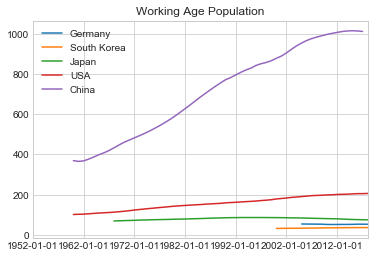

In [25]:
df_countries.plot(title='Working Age Population')

In [26]:
df_temp = df_countries.copy()

In [27]:
# Normalize data
df_temp2 = (df_temp - df_temp.min()) / (df_temp.max() - df_temp.min())

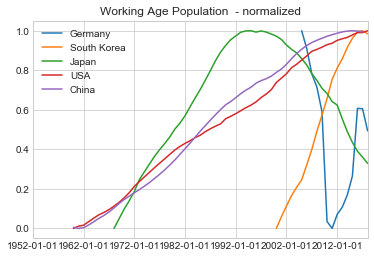

In [28]:
df_temp2.plot(title='Working Age Population  - normalized')

In [29]:
df_temp3 = df_temp / df_temp.max()

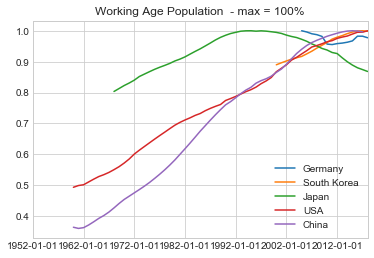

In [30]:
df_temp3.plot(title='Working Age Population  - max = 100%')

In [31]:
working_dir - '/Users/brianmckean/Dropbox/ChinaEconomy/'

'/Users/brianmckean/Dropbox/projects/econ/fred'

In [ ]:
data_file = 'fred_population'